#### TOC
1. Anomalies in Data, and cleaning action & explaination. 15 pts
2. Pairwise Corralation Table and explaition. 10 pts
3. Average records stockID vs Day, 25 pts
    - a. autocorrelation, 10 pts
    - b. measure the distance, 5 pts
    - c. clustering algorithm, 10 pts
4. Closing trajectory of stocks on each day highly correlated, 25 pts
   - a. Make three plots, 10 pts
   - b. permutation test to determine the statistical confidence, 15 pts
      p-value
5. Best prediction model, any approaches, 25 pts
6. submit model on Kaggle, 0 pts

#### Start
- Copy this notebook.
  In Google Colab use `File -> Save a Copy in Drive`.
- Use the "Text" blocks to provide explanations wherever you find them necessary.
- Highlight your answers inside these text fields to ensure that we don't miss it
while grading your HW.

#### Setup

- Code to download the data directly from the colab notebook.
- If you find it easier to download the data from the kaggle website (and
uploading it to your drive), you can skip this section.

In [4]:
## First mount your drive before running analysis code
from google.colab import drive
drive.mount('/content/drive')

## Create a folder for the this HW and change to that dir
%cd drive/MyDrive/cse519


Mounted at /content/drive
/content/drive/MyDrive/cse519


In [2]:
## packages
!pip install -q kaggle
!pip install -q pandas
!pip install -q scikit-learn
!pip install -q numpy
!pip install -q Matplotlib
!pip install -q seaborn
# Install or upgrade required libraries
!pip install -q numpy pandas matplotlib seaborn optuna statsmodels scikit-learn lightgbm xgboost catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 409.6/409.6 kB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.0/226.0 kB 21.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 8.8 MB/s eta 0:00:00


In [5]:
## Upload the file by clicking on the browse
from google.colab import files
files.upload()

## Create a new API token under "Account" in the kaggle webpage and download the json file

{}

In [5]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!kaggle competitions download -c optiver-trading-at-the-close
!unzip optiver-trading-at-the-close.zip
!ls

optiver-trading-at-the-close.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  optiver-trading-at-the-close.zip
replace example_test_files/revealed_targets.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: N
distances_dataframe_2.csv   example_test_files	optiver-trading-at-the-close.zip
distances_dataframe.csv     kaggle.json		public_timeseries_testing_util.py
distances_dataframe.gsheet  optiver2023		train.csv


#### Q1: Anomalies and Cleaning, 15 pts


In [6]:
import sys
import os
import collections

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import seaborn as sns

import statsmodels.api as sm
import statsmodels.tsa.api as smt
import statsmodels.graphics.api as smg

import sklearn as sk

%matplotlib inline
plt.style.use('bmh')

In [7]:


col_names = [
  "stock_id",
  "date_id",
  "seconds_in_bucket",
  "imbalance_size",
  "imbalance_buy_sell_flag",
  "reference_price",
  "matched_size",
  "far_price",
  "near_price",
  "bid_price",
  "bid_size",
  "ask_price",
  "ask_size",
  "wap",
  "target",
  "time_id",
  "row_id"
]
dtypes = {
  "stock_id": int,
  "date_id":int,
  "seconds_in_bucket":int,
  "imbalance_size":np.float64,
  "imbalance_buy_sell_flag":int,
  "reference_price":np.float64,
  "matched_size":np.float64,
  "far_price":np.float64,
  "near_price":np.float64,
  "bid_price":np.float64,
  "bid_size":np.float64,
  "ask_price":np.float64,
  "ask_size":np.float64,
  "wap":np.float64,
  "target":np.float64,
  "time_id": int,
  "row_id": "string",
}
df = pd.read_csv("train.csv")


In [8]:
df

,stock_id,date_id,seconds_in_bucket,imbalance_size,imbalance_buy_sell_flag,reference_price,matched_size,far_price,near_price,bid_price,bid_size,ask_price,ask_size,wap,target,time_id,row_id
0,0,0,0,3180602.69,1,0.999812,13380276.64,NaN,NaN,0.999812,60651.50,1.000026,8493.03,1.000000,-3.029704,0,0_0_0
1,1,0,0,166603.91,-1,0.999896,1642214.25,NaN,NaN,0.999896,3233.04,1.000660,20605.09,1.000000,-5.519986,0,0_0_1
2,2,0,0,302879.87,-1,0.999561,1819368.03,NaN,NaN,0.999403,37956.00,1.000298,18995.00,1.000000,-8.389950,0,0_0_2
3,3,0,0,11917682.27,-1,1.000171,18389745.62,NaN,NaN,0.999999,2324.90,1.000214,479032.40,1.000000,-4.010200,0,0_0_3
4,4,0,0,447549.96,-1,0.999532,17860614.95,NaN,NaN,0.999394,16485.54,1.000016,434.10,1.000000,-7.349849,0,0_0_4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5237975,195,480,540,2440722.89,-1,1.000317,28280361.74,0.999734,0.999734,1.000317,32257.04,1.000434,319862.40,1.000328,2.310276,26454,480_540_195
5237976,196,480,540,349510.47,-1,1.000643,9187699.11,1.000129,1.000386,1.000643,205108.40,1.000900,93393.07,1.000819,-8.220077,26454,480_540_196
5237977,197,480,540,0.00,0,0.995789,12725436.10,0.995789,0.995789,0.995789,16790.66,0.995883,180038.32,0.995797,1.169443,26454,480_540_197
5237978,198,480,540,1000898.84,1,0.999210,94773271.05,0.999210,0.999210,0.998970,125631.72,0.999210,669893.00,0.999008,-1.540184,26454,480_540_198


In [ ]:
# Data Preprocessing
#Remove NaN values, imputation, etc.


# Data Columns Inspection

In [ ]:
def inspect_columns(data):
    # A helper function that does a better job than df.info() and df.describe()
    result = pd.DataFrame({
        'unique': data.nunique() == len(data),
        'with_null': data.isna().any(),
        'null_percentage': round((data.isnull().sum() / len(data)) * 100, 2),
        'first_row': data.iloc[0],
        'random_row': data.iloc[np.random.randint(low=0, high=len(data))],
        'last_row': data.iloc[-1],
        'cardinality': data.nunique(),
        'dtype': data.dtypes
    })
    return result

In [ ]:
inspect_columns(df)

,unique,with_null,null_percentage,first_row,random_row,last_row,cardinality,dtype
stock_id,False,False,0.00,0,185,199,200,int64
date_id,False,False,0.00,0,237,480,481,int64
seconds_in_bucket,False,False,0.00,0,320,540,55,int64
imbalance_size,False,True,0.00,3180602.69,1554119.82,1884285.71,2971863,float64
imbalance_buy_sell_flag,False,False,0.00,1,-1,-1,3,int64
reference_price,False,True,0.00,0.999812,0.997561,1.002129,28741,float64
matched_size,False,True,0.00,13380276.64,15624995.1,24073677.32,2948862,float64
far_price,False,True,55.26,NaN,0.978812,1.000859,95739,float64
near_price,False,True,54.55,NaN,0.987767,1.001494,84625,float64
bid_price,False,True,0.00,0.999812,0.997441,1.002129,28313,float64


Based on a brief overview of the data, we can make the following observations:

The total number of rows is approximately **200 x 55 x 481 = 5,291,000** which closely matches the number of total rows.

It is assumed that the training data comprises **200 x 481 = 96,200** time series. Each of these time series is composed of **55 steps**, representing the last 10 minutes of a particular stock on a specific trading date, which is the auction time.

There is a discrepancy of **53,020 rows (5,291,000 - 5,237,980)**, which indicates that some data is **missing**. This is a common occurrence, as explained in the Dataset Description: **not all stock IDs are present in every time bucket**.

We will delve deeper into understanding the nature of the missing data.

The number 26,455 is obtained by multiplying 481 and 55, which implies that the time_id is a new identifier resulting from the permutation of seconds_in_bucket and date_id.

The columns that are not **target** can be considered features in the context of Data Science.

# Missing Data analysis:
There are 3 possible scenarios:


*   Do we have entire time series missing, such as days when certain stocks have no data at all?
*   Are there incomplete time series with fewer steps than the expected 55, indicating missing data points?
*   Is it a combination of both scenarios, with some time series missing entirely and others lacking some of their steps?


In [ ]:
(df.groupby(['stock_id', 'date_id'])
    ['seconds_in_bucket'] # Extract the column of interest
    .count() # Count the number of rows in each permutation of stock_id and date_id
    .apply(lambda x: x == 55) # Check if every count is 55
    .all() # Check if all the booleans are True
)

True

The above resulting in **"True"** suggests that all the time series in our training data are of the same length of 55. There have been no skips in data points for stocks mentioned. If there is a stock traded on a particular day, it has all the 55 time buckets in the data. Otherwise, the stock will not be traded on that day during auction time at all.

Therefore, it can be concluded that SCENARIO 2: **there are some stocks missing data on some days entirely** can be expected from the given dataset.

# NaN values analysis:

In [ ]:
df.isna().sum()

stock_id                         0
date_id                          0
seconds_in_bucket                0
imbalance_size                 220
imbalance_buy_sell_flag          0
reference_price                220
matched_size                   220
far_price                  2894342
near_price                 2857180
bid_price                      220
bid_size                         0
ask_price                      220
ask_size                         0
wap                            220
target                          88
time_id                          0
row_id                           0
dtype: int64

Since there are 88 target values missing, they cannot contribute to the training of the model. We need to drop those rows.

Far Price and Near Price start at 300 seconds each auction day, hence their values will be NaN till 300 seconds, hence their records make logical sense and need not be changed.

Imbalance_size, Reference_price, matched_size, bid_price, ask_price and wap are missing for a total of 220 rows. Are they all the same records? Let's analyze this hypothesis further. If they are missing from the same 220 rows, their intersection will be equal to exactly 220 rows that need to be handled.


In [ ]:
columns_with_nulls = ["imbalance_size", "reference_price", "matched_size", "bid_price", "ask_price", "wap"]

null_mask = df[columns_with_nulls].isna()

rows_with_common_nulls = null_mask.all(axis=1)

null_result_df = df[rows_with_common_nulls]

null_result_df

,stock_id,date_id,seconds_in_bucket,imbalance_size,imbalance_buy_sell_flag,reference_price,matched_size,far_price,near_price,bid_price,bid_size,ask_price,ask_size,wap,target,time_id,row_id
369508,131,35,0,NaN,0,NaN,NaN,NaN,NaN,NaN,0.00,NaN,0.00,NaN,NaN,1925,35_0_131
369700,131,35,10,NaN,0,NaN,NaN,NaN,NaN,NaN,0.00,NaN,0.00,NaN,NaN,1926,35_10_131
369892,131,35,20,NaN,0,NaN,NaN,NaN,NaN,NaN,0.00,NaN,0.00,NaN,NaN,1927,35_20_131
370084,131,35,30,NaN,0,NaN,NaN,NaN,NaN,NaN,0.00,NaN,0.00,NaN,NaN,1928,35_30_131
370276,131,35,40,NaN,0,NaN,NaN,NaN,NaN,NaN,0.00,NaN,0.00,NaN,NaN,1929,35_40_131
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4774999,19,438,500,NaN,-1,NaN,NaN,NaN,NaN,NaN,115491.18,NaN,1990.10,NaN,3.319979,24140,438_500_19
4775199,19,438,510,NaN,-1,NaN,NaN,NaN,NaN,NaN,189040.50,NaN,26283.84,NaN,-5.049705,24141,438_510_19
4775399,19,438,520,NaN,-1,NaN,NaN,NaN,NaN,NaN,1392.93,NaN,43799.80,NaN,-0.110269,24142,438_520_19
4775599,19,438,530,NaN,-1,NaN,NaN,NaN,NaN,NaN,13531.32,NaN,26881.20,NaN,-1.689792,24143,438_530_19


We see 220 rows here after taking the union of all NaN rows and on observing the rows in the null_result_df above, we see that there are only 220 rows in total, hence the missing rows for the columns we considered were all in the same records. Removing 220 rows is nearly 0% of all data in such a large dataset should not affect the overall model training.

####Hence can identify three distinct categories of missing values within the dataset:


*   There are 88 instances of missing target values, and it is permissible to eliminate the corresponding rows since it too small in the dataset of more than 95000-ish rows. At this moment, I have chosen to retain these rows for analytical purposes but plan to drop them when it comes to model training since it wont give any training help as target itself is missing.
*   The dataset also includes 220 missing values in various features, such as "imbalance size," "reference price," "matched size," "bid price," "ask price," and "wap." I have opted to retain the rows with missing reference prices and other columns, as they constitute a relatively small proportion and are unlikely to significantly impact the analysis in my view. I will be dropping me specifically in different sections where NaN values need handling and we dont need all time buckets in a series.
*   Approximately half of the missing values are found in the "Far Price" and "Near Price" columns. This is primarily because these particular features are computed exclusively during the final 5 minutes of the auction. Given that there are 540 seconds in each trading session for every stock, data pertaining to these two features is only available within the time range of [300, 540]. We are unable to remove these rows containing missing data, as they contain other essential information necessary for subsequent analysis.














# Q2: Pairwise Correlation Table and Explanation. 10 pts


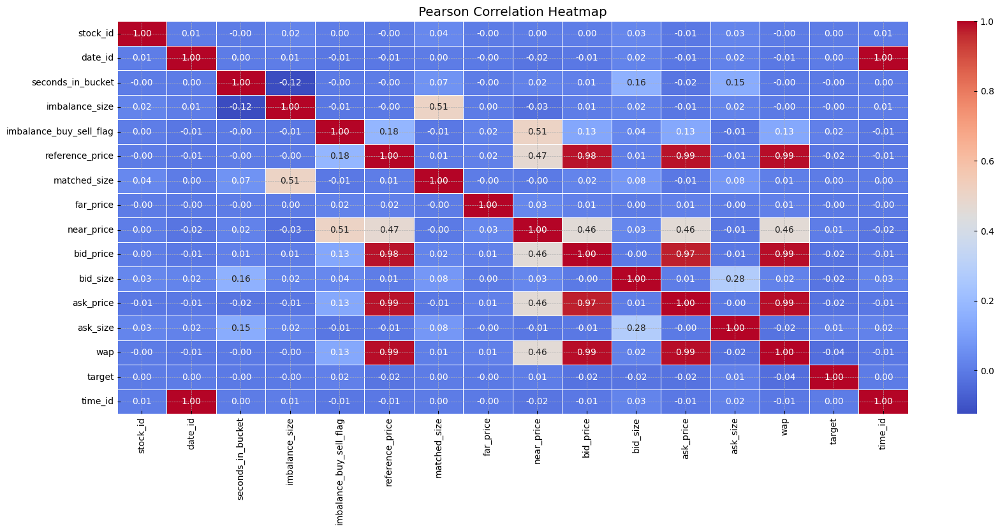

Highly correlated variables: date_id and time_id, Correlation: 0.9999978295777053
Highly correlated variables: bid_price and wap, Correlation: 0.9892766137338921
Highly correlated variables: ask_price and wap, Correlation: 0.988907415826105
Highly correlated variables: reference_price and wap, Correlation: 0.9881125179989924
Highly correlated variables: reference_price and ask_price, Correlation: 0.9850676336652473
Highly correlated variables: reference_price and bid_price, Correlation: 0.9836463226181371
Highly correlated variables: bid_price and ask_price, Correlation: 0.972905836939057


In [ ]:
# Step 3: Calculate the Pearson correlation matrix
correlation_matrix = df.corr(method='pearson', numeric_only=True)

# Step 4: Visualize the correlation matrix using a heatmap
plt.figure(figsize=(20, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Pearson Correlation Heatmap')
plt.show()

# Step 5: Identify pairs of variables with high absolute correlations
threshold = 0.7  # You can adjust this threshold as needed
highly_correlated_pairs = []
for i in range(len(correlation_matrix.columns)):
    for j in range(i+1, len(correlation_matrix.columns)):
        correlation = correlation_matrix.iloc[i, j]
        if abs(correlation) > threshold:
            highly_correlated_pairs.append((correlation, correlation_matrix.columns[i], correlation_matrix.columns[j]))

highly_correlated_pairs.sort(reverse=True)  # Sort by correlation coefficient

# Step 6: Explain why highly correlated pairs are so
for correlation, var1, var2 in highly_correlated_pairs:
    print(f"Highly correlated variables: {var1} and {var2}, Correlation: {correlation}")
    # Provide domain-specific knowledge to explain why these variables are correlated.


The dataset displays the pairwise correlation among its features, as shown above. Several feature pairs exhibit notably high correlations. Let's delve deeper into understanding the reasons behind these correlations.

**time_id vs date_id:** Notably, there is an absolute positive correlation between time_id and date_id. This correlation arises from the fact that time_id quantifies the number of 10-second intervals that have elapsed since the beginning of the dataset, while date_id serves as a counter for individual days, where each day consists of 55 such time_id intervals.

**wap vs bid_price and wap vs ask_price:** The strong correlation observed between wap (Weighted Average Price) and bid_price, as well as wap and ask_price, can be attributed to the calculation of wap itself. Wap is computed using the formula [(bid_price * ask_size) + (ask_price * bid_size)] / (bid_size + ask_size). Consequently, an increase in wap implies higher bid_price and ask_price, and vice versa. This relationship results in a robust correlation.

**wap vs reference_price:** The correlation between wap and reference_price can be understood by considering that wap is confined to the range between the best bid price and the best ask price. When the near price falls between the best bid and ask prices, the reference_price is equivalent to the near price. The dataset reflects this pattern, with the values of reference_price and wap showing similarity across different seconds_in_bucket. This indicates that both wap and reference_price lie within the boundaries set by the best bid and ask prices.

**reference_price vs bid_price and reference_price vs ask_price:** Given the strong correlation between wap and bid_price, ask_price, and reference_price, we can deduce that the reference_price is similarly strongly correlated with bid_price and ask_price. This relationship can be explained using the transitive property of equality, as it arises from the interplay of these correlated features.

# Q3A: Average records stockID vs Day, 25 pts
distance function between entries
- a. autocorrelation, 10 pts



In [9]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import euclidean_distances

In order to derive the mean consensus record, my approach was to compute the average across all the attributes associated with a specific stock on a given day. This aggregation effectively compresses the dataset, resulting in a new configuration with dimensions of [rows: 480*200, columns: 16]. The objective here is to assess the performance of stock 's' as it approaches the closing price on day 'd,' and this process is illustrated below:

In [10]:
# Group by 'stock_id' and 'date_id' and calculate the mean for each group
grouped = df.groupby(['stock_id', 'date_id']).mean(numeric_only = True)

# Reset the index to have 'stock_id' and 'date_id' as columns
grouped = grouped.reset_index()

# Now, 'grouped' contains the mean values for each stock for each day
grouped.isna().sum()

stock_id                    0
date_id                     0
seconds_in_bucket           0
imbalance_size              4
imbalance_buy_sell_flag     0
reference_price             4
matched_size                4
far_price                  24
near_price                  4
bid_price                   4
bid_size                    0
ask_price                   4
ask_size                    0
wap                         4
target                      1
time_id                     0
dtype: int64

Subsequently, I formulated a dissimilarity metric for pairs of "stock-day" distance records, which quantifies their similarity. My chosen metric for this task is the Euclidean Distance. In order to execute this analysis, we must account for multiple time lags to identify when the stock data patterns repeat over time. I opted to compute row-wise Euclidean Distances for 10 distinct lag values, ranging from 1 to 10. This process resulted in the creation of a temporary dataframe characterized by the following attributes: [stock_id, lag, distances]. Within this dataframe, each stock and its corresponding 10 lag values are associated with a 'distances' feature, which contains a list of Euclidean Distance values. These distances were computed by measuring the stock's relationship with its lagged counterparts.

In [11]:
from sklearn.metrics.pairwise import euclidean_distances

In [9]:
# Create a list of unique stock IDs
stock_ids = grouped['stock_id'].unique()

# Initialize an empty list to store the distances
distances_list = []

# Loop through each stock
for stock_id in stock_ids:
    stock_data = grouped[grouped['stock_id'] == stock_id]
    stock_data_og = grouped[grouped['stock_id'] == stock_id]

    lag_distances = []

    # Loop over each lag from 1 to 10
    for lag in range(1, 11):
        # Shift the stock data to create lagged data
        lagged_stock_data = stock_data_og.shift(periods=lag).iloc[lag:]
        stock_data = stock_data.iloc[1:]

        # Get the relevant columns as NumPy arrays
        original_data = stock_data.iloc[:, 3:-1].to_numpy()
        lagged_data = lagged_stock_data.iloc[:, 3:-1].to_numpy()

        # Calculate Euclidean distances for each day
        distances = np.linalg.norm(original_data - lagged_data, axis=1)
        lag_distances.append(distances)

    # Append distances to the list
    distances_list.append(lag_distances)

# Create a DataFrame from the list of distances
stacked_distances = np.vstack(distances_list)
distances_df = pd.DataFrame(stacked_distances, columns=[i for i in range(1, 11)])

# Add the 'stock_id' column
distances_df['stock_id'] = np.repeat(stock_ids, 1)

# Melt the DataFrame to the desired format
distances_df = pd.melt(distances_df, id_vars=['stock_id'], var_name='lag', value_name='distances')

distances_df

/usr/local/lib/python3.10/dist-packages/numpy/core/shape_base.py:121: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)


,stock_id,lag,distances
0,0,1,"[11306328.076295992, 3903078.5277153044, 54876..."
1,1,1,"[1363408.6322354046, 1452440.6332654464, 48176..."
2,2,1,"[3260089.9622090454, 3221599.070130651, 130172..."
3,3,1,"[6495918.632724782, 15424992.217748843, 167373..."
4,4,1,"[14045533.383200593, 1765561.1789085362, 30304..."
...,...,...,...
1995,195,10,"[4853272.011238183, 6202538.909981853, 6961561..."
1996,196,10,"[2393011.5272410708, 2936068.4579885327, 31818..."
1997,197,10,"[2741504.3458853518, 1099624.1954391766, 19265..."
1998,198,10,"[41048828.095363036, 11294251.954131933, 24397..."


In [ ]:
################### OLD CODE  ##########################

# # Create a list of unique stock IDs
# stock_ids = grouped['stock_id'].unique()

# # Initialize an empty DataFrame to store the distances
# distances_df = pd.DataFrame(columns=['stock_id', 'lag', 'distances'])

# # Loop through each stock
# for stock_id in stock_ids:
#     stock_data = grouped[grouped['stock_id'] == stock_id]
#     stock_data_og = grouped[grouped['stock_id'] == stock_id]

#     lag_distances = []

#     # Loop over each lag from 1 to 10
#     for lag in range(1, 11):  # You can adjust the lag range as needed
#         # Shift the stock data to create lagged data
#         lagged_stock_data = stock_data_og.shift(periods=lag)
#         stock_data = stock_data.iloc[1:]
#         lagged_stock_data = lagged_stock_data.iloc[lag:]


#         # Calculate Euclidean distances for each day (date_id)
#         day_distances = []
#         for i in range(len(stock_data)):
#             original_day = stock_data.iloc[i, 3:-1]
#             lagged_day = lagged_stock_data.iloc[i, 3:-1]

#             # Check if both original_day and lagged_day are not empty
#             if not original_day.isnull().any() and not lagged_day.isnull().any():
#                 distance = np.linalg.norm(original_day - lagged_day)
#                 day_distances.append(distance)

#         # Append distances to the list
#         lag_distances.append(day_distances)

#     # Create a DataFrame for the stock with distances for different lags
#     stock_distances_df = pd.DataFrame({'stock_id': stock_id, 'lag': range(1, 11), 'distances': lag_distances})

#     # Append the stock's distances DataFrame to the main distances_df
#     distances_df = pd.concat([distances_df, stock_distances_df], ignore_index=True)


# # The distances_df DataFrame now contains distances for each stock's features lagged from 1 to 10 days for all days in the dataset.


# distances_df

In [ ]:
# import ast
# def convert_distances(value):
#     return ast.literal_eval(value)

# # Read the CSV file with the converter
# distances_df = pd.read_csv('distances_dataframe.csv', converters={'distances': convert_distances})


In [ ]:
# distances_df.drop('Unnamed: 0', axis=1)

In [ ]:
# distances_df.to_csv("distances_dataframe_2.csv")

In [59]:
first_10_rows = distances_df[distances_df['stock_id']==0].head(10)
length_of_distances = first_10_rows['distances'].apply(len)

length_of_distances

0       480
200     479
400     478
600     477
800     476
1000    475
1200    474
1400    473
1600    472
1800    471
Name: distances, dtype: int64

We can see the length of list of distances for each lag is decreasing by 1 when lag increases by 1. This is logically sound since:

the last iteration for lag=1 will stop when second last value is compared to the last value = 480 values

the last iteration for lag=2 will stop when third last value is compared to the last value = 479 values

the last iteration for lag=3 will stop when fourth last value is compared to the last value = 478 values

In this step, I **standardized the distance lists** for each stock and their respective lag values. I then introduced an additional feature to the dataframe, which represents the average of the distance values within each list across all the rows.

In [60]:
from sklearn.preprocessing import MinMaxScaler

# Create an instance of the MinMaxScaler
scaler = MinMaxScaler()

# Define a function to normalize a list
def normalize_list(distances):
    distances_2d = [[x] for x in distances]
    normalized_distances = scaler.fit_transform(distances_2d)
    return [x[0] for x in normalized_distances]

# Apply the function to each row in the DataFrame
distances_df['normalized_distances'] = distances_df['distances'].apply(normalize_list)

def calculate_average(distances):
    return sum(distances) / len(distances)

# Apply the function to each row in the DataFrame
distances_df['average_normalized_distance'] = distances_df['normalized_distances'].apply(calculate_average)

distances_df


,stock_id,lag,distances,normalized_distances,average_normalized_distance
0,0,1,"[11306328.076295992, 3903078.5277153044, 54876...","[0.06828417724574534, 0.02294370444067311, 0.0...",0.088245
1,1,1,"[1363408.6322354046, 1452440.6332654464, 48176...","[0.004991885194228867, 0.005326704360201237, 0...",0.011078
2,2,1,"[3260089.9622090454, 3221599.070130651, 130172...","[0.0027899647950954897, 0.002756630186290098, ...",0.010065
3,3,1,"[6495918.632724782, 15424992.217748843, 167373...","[0.011526033464411299, 0.02840134306512046, 0....",0.065423
4,4,1,"[14045533.383200593, 1765561.1789085362, 30304...","[0.054887962476327906, 0.005932681911649723, 0...",0.052519
...,...,...,...,...,...
1995,195,10,"[4853272.011238183, 6202538.909981853, 6961561...","[0.02344461009418157, 0.030798527521379397, 0....",0.084194
1996,196,10,"[2393011.5272410708, 2936068.4579885327, 31818...","[0.04154060088121371, 0.051171910849838353, 0....",0.079502
1997,197,10,"[2741504.3458853518, 1099624.1954391766, 19265...","[0.009310384495541058, 0.003268008803924909, 0...",0.037762
1998,198,10,"[41048828.095363036, 11294251.954131933, 24397...","[0.058955018638219774, 0.014192385751932534, 0...",0.082591


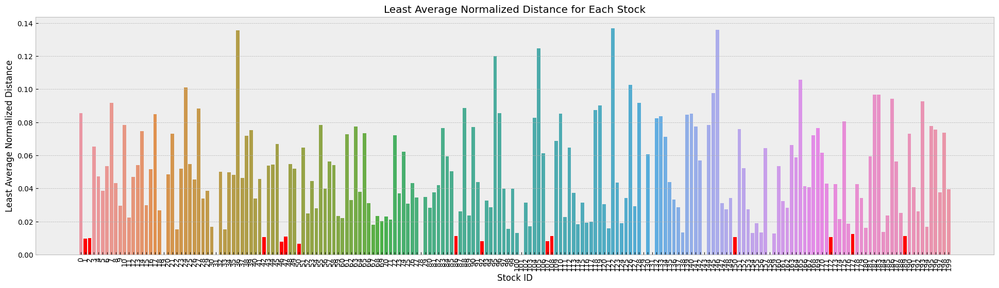

Highest correlation(least distance value) of a stock across lags:


,stock_id,lag,min_average_distances
0,1,10,0.009610
1,2,1,0.010065
2,42,9,0.010624
3,46,1,0.007687
4,47,8,0.010885
5,50,1,0.006604
6,86,1,0.011118
7,92,1,0.008203
8,107,1,0.007929
9,108,1,0.011268


In [61]:
# Group by stock_id and find the minimum average_normalized_distance
min_average_distances = distances_df.groupby('stock_id')['average_normalized_distance'].min()

# Calculate 1 - least_average_normalized_distance
# min_average_distances = 1 - min_average_distances

# Plot the result
plt.figure(figsize=(24, 6))
sns.barplot(x=min_average_distances.index, y=min_average_distances)
plt.xlabel('Stock ID')
plt.ylabel('Least Average Normalized Distance')
plt.title('Least Average Normalized Distance for Each Stock')

df_least_dist=[]

# Highlight values less than 0.2
for i, val in enumerate(min_average_distances):
    if val < 0.0125:
        plt.bar(min_average_distances.index[i], val, color='red')
        df_least_dist.append([min_average_distances.index[i], distances_df[distances_df['average_normalized_distance'] == val]['lag'].values[0], val])


# Rotate stock ID ticks by 90 degrees for better readability
plt.xticks(min_average_distances.index, rotation=90)

plt.show()
print("Highest correlation(least distance value) of a stock across lags:")
df_least_dist = pd.DataFrame(df_least_dist, columns=["stock_id", "lag", "min_average_distances"])
df_least_dist

Upon scrutinizing the above visual representation, I established a threshold of 0.0125 to identify the stock with the lowest average normalized distance. For a more comprehensive examination, I organized the dataframe by sorting it based on these minimal average distances. This procedure enabled me to pinpoint the lag value for each stock at which its trend repetition becomes apparent.

Through the previously described analysis, it became evident that the majority of stocks exhibited a recurring pattern with a one-day lag, indicating that significant fluctuations were relatively infrequent.

Specific stocks that demonstrated an unusually strong autocorrelation, exhibiting statistically significant trends, were identified as shown in the dataframe above with their corresponding lags.

# Q3B: Average records stockID vs Day, 25 pts
- b. measure the distance, 5 pts
- c. clustering algorithm, 10 pts

In [10]:
import pandas as pd
from scipy.spatial import distance
from sklearn.preprocessing import MinMaxScaler

In [63]:

mean_per_stock = df.groupby(['stock_id','date_id']).mean()
#mean_per_stock = csv.groupby(['stock_id'])['imbalance_size','reference_price','far_price','near_price','bid_price','bid_size','ask_price','ask_size','wap'].mean()
mean_per_stock = mean_per_stock.reset_index()

# temp = mean_per_stock
# temp.drop(['stock_id','date_id'])

# Fit and transform the DataFrame to normalize the values

columns_to_normalize = ['imbalance_size','matched_size','reference_price','far_price','near_price','bid_price','bid_size','ask_price','ask_size','wap']
scaler = MinMaxScaler()

mean_per_stock[columns_to_normalize] = scaler.fit_transform(mean_per_stock[columns_to_normalize])
# Create a new DataFrame with the normalized values


normalized_df = mean_per_stock

normalized_df

<ipython-input-63-f3cbe4f219bc>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mean_per_stock = df.groupby(['stock_id','date_id']).mean()


,stock_id,date_id,seconds_in_bucket,imbalance_size,imbalance_buy_sell_flag,reference_price,matched_size,far_price,near_price,bid_price,bid_size,ask_price,ask_size,wap,target,time_id
0,0,0,270.0,0.000858,0.709091,0.371699,0.002866,0.002756,0.363022,0.416227,0.013036,0.361796,0.013013,0.392697,-0.734535,27.0
1,0,1,270.0,0.000821,1.000000,0.363059,0.001294,0.002853,0.376962,0.406552,0.014027,0.353188,0.009688,0.383537,0.328942,82.0
2,0,2,270.0,0.000011,0.036364,0.361512,0.001813,0.002745,0.358818,0.406420,0.012285,0.352445,0.014461,0.382976,-0.326709,137.0
3,0,3,270.0,0.003767,-1.000000,0.360714,0.001962,0.002536,0.115035,0.405508,0.016077,0.352115,0.028751,0.382330,-3.225099,192.0
4,0,4,270.0,0.002885,-1.000000,0.386127,0.002613,0.002620,0.310763,0.432608,0.011346,0.379241,0.021710,0.409574,-1.614007,247.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95231,199,476,270.0,0.001602,0.781818,0.384445,0.002900,0.002891,0.383966,0.427405,0.029716,0.374816,0.035616,0.404953,0.966506,26207.0
95232,199,477,270.0,0.002672,-0.981818,0.348176,0.001856,0.002427,0.270734,0.392068,0.022370,0.341394,0.023894,0.370169,-4.226023,26262.0
95233,199,478,270.0,0.000764,0.872727,0.389799,0.001498,0.002879,0.384935,0.432991,0.027139,0.380048,0.025687,0.410810,1.323126,26317.0
95234,199,479,270.0,0.001636,0.145455,0.408118,0.003851,0.003102,0.456555,0.454288,0.032506,0.400213,0.019408,0.432320,3.300006,26372.0


In this segment of the analysis, I initiated the normalization process for a specific subset of features within the dataset. These selected features included ['imbalance_size', 'matched_size', 'reference_price', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price', 'ask_size', 'wap'].

The decision to exclude other features was made because they did not provide any meaningful contribution to the analysis.

In [ ]:
range_nums = np.arange(0,200)
consensus_date = []
for date in range(481):
  date_df = normalized_df[normalized_df['date_id'] == date].set_index('stock_id')
  date_df = date_df.drop(columns=['date_id'])
  consensus_date.append(date_df.apply(lambda x: date_df.apply(lambda y: np.linalg.norm(x.to_numpy()-y.to_numpy()), axis=1), axis=1))
  consensus_date[date] = consensus_date[date].reindex(index=range_nums, columns=range_nums)
  consensus_date[date] = consensus_date[date].fillna(np.inf)

#consensus_date
schema = consensus_date[0]

array_of_arrays = [df.to_numpy() for df in consensus_date]

# Stack arrays along a new axis to create a 3D array
stacked_array = np.stack(array_of_arrays, axis=2)

# Calculate the standard deviation along the new axis (axis=2)
std_deviation = np.std(stacked_array, axis=2)

# Create a DataFrame from the standard deviation array
result_df = pd.DataFrame(std_deviation, columns=schema.columns)

result_df

/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:233: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


stock_id,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
0,0.000000,2.193878,2.596376,1.281356,1.525796,2.282283,1.582476,1.886128,1.536119,1.566243,...,1.900730,2.028026,1.465746,1.782395,1.934818,1.314263,1.419687,1.937534,1.321592,NaN
1,2.193878,0.000000,2.617802,2.170370,2.025943,2.483583,2.007455,2.227414,2.215044,2.339062,...,2.239334,2.445314,2.192361,2.463176,2.425123,2.179398,2.273134,2.317913,2.263365,NaN
2,2.596376,2.617802,0.000000,2.647501,2.524960,2.817302,2.686596,2.742514,2.675332,2.678503,...,2.752084,2.980813,2.708125,2.861742,2.786524,2.544916,2.812356,2.810245,2.602809,NaN
3,1.281356,2.170370,2.647501,0.000000,1.553426,2.230372,1.606505,1.890286,1.452114,1.507050,...,1.825834,2.139856,1.364039,1.553471,1.933243,1.322032,1.461153,1.742667,1.264075,NaN
4,1.525796,2.025943,2.524960,1.553426,0.000000,2.213826,1.675447,1.861584,1.573365,1.603124,...,1.795924,2.019970,1.499502,2.054428,1.771859,1.446116,1.619309,1.957588,1.478740,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,1.314263,2.179398,2.544916,1.322032,1.446116,2.296552,1.589774,2.155996,1.568950,1.441507,...,1.919177,2.261527,1.486172,1.948837,2.026296,0.000000,1.403562,1.922503,1.213316,NaN
196,1.419687,2.273134,2.812356,1.461153,1.619309,2.304963,1.725619,2.129870,1.720714,1.716235,...,1.854437,2.287415,1.676072,1.994656,2.081261,1.403562,0.000000,2.055487,1.540975,NaN
197,1.937534,2.317913,2.810245,1.742667,1.957588,2.337467,1.989442,2.135695,1.836567,2.022805,...,2.112298,2.359252,1.831954,1.931715,2.204334,1.922503,2.055487,0.000000,1.865781,NaN
198,1.321592,2.263365,2.602809,1.264075,1.478740,2.224316,1.660179,2.024759,1.557059,1.462216,...,1.880636,2.104340,1.450065,1.810573,2.013737,1.213316,1.540975,1.865781,0.000000,NaN


For each day I obtained the euclidean distances between each stock pairs and saved them in a consolidated list. Then we stacked all the matrices to form a 3D data structure where X-axis and Y-axis correspond to 200 stocks and each channel of this data structure has euclidean distance values.

Now I chose to find the standard deviations for each stock pair across all channels to identify the stock pairs for which euclidean distances almost remain the same and standard deviation is low. The reason I chose standard deviation to detect similarity in euclidean distances is because the normal distribution with least standard deviation indicates most of the values being similar.

In [40]:

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Define the threshold for highlighting
threshold = 0.6  # Values less than this threshold will be highlighted

# Create a heatmap
plt.figure(figsize=(100, 100))
ax = sns.heatmap(result_df, annot=True, cmap='coolwarm', linewidths=0.5, linecolor='gray', cbar=False)

# Highlight values less than the threshold
for i in range(len(result_df)):
    for j in range(len(result_df.columns)):
        if result_df.iloc[i, j] < threshold:
            ax.add_patch(plt.Rectangle((j, i), 1, 1, fill="black", edgecolor='red', lw=2))

plt.show()

Upon a thorough examination of the heatmap depicted above, a noteworthy observation emerged. It became evident that

 the stock pair {84, 175} exhibited an exceptionally low standard deviation of , which is indicated by the prominent dark blue shading in the heatmap.

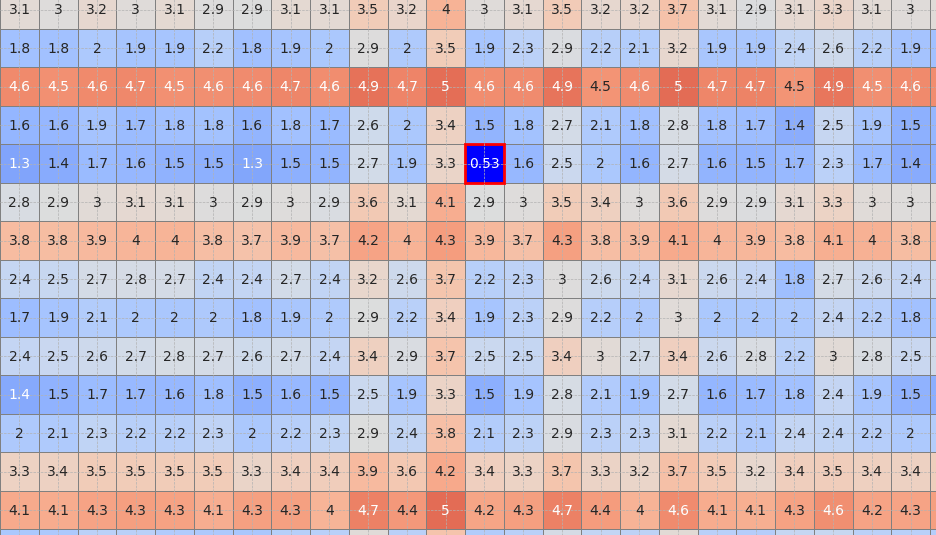

To perform a validation check, we will randomly select 6 dates for the stock pair and generate plots illustrating their respective standard deviations. By visually inspecting these graphs, we can ascertain whether there is any noticeable resemblance in the trends between the two stocks, namely, 84 and 175.

Upon examining the generated graphs, it becomes evident that on randomly selected days, stocks 84 and 175 exhibit comparable patterns.

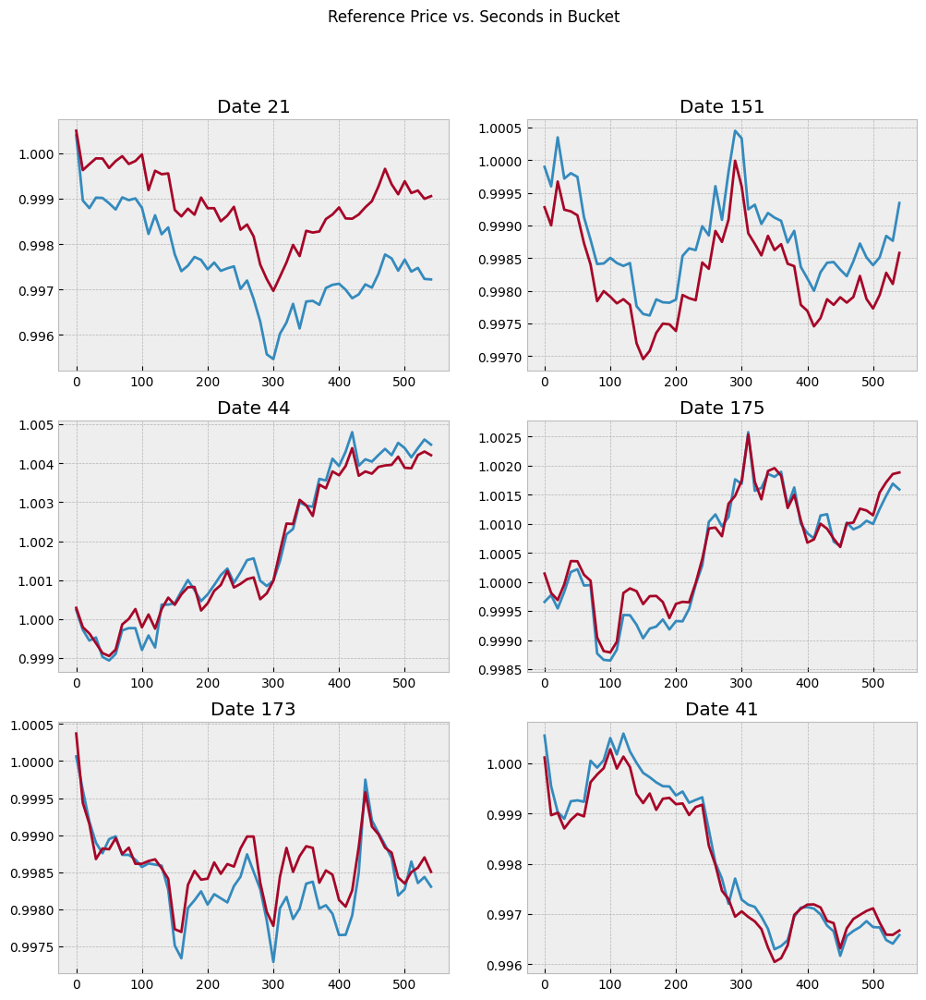

In [40]:
import matplotlib.pyplot as plt
import random

random.seed(91)  # For reproducibility
dates = random.sample(range(199), 6)  # Select 6 random dates

fig, axs = plt.subplots(3, 2, figsize=(12, 12))
fig.suptitle('Reference Price vs. Seconds in Bucket')

for i, date in enumerate(dates):
    row, col = i // 2, i % 2
    ax = axs[row, col]

    for stock_id in [84, 175]:
        x = df[(df['date_id'] == date) & (df['stock_id'] == stock_id)]['seconds_in_bucket']
        y = df[(df['date_id'] == date) & (df['stock_id'] == stock_id)]['reference_price']
        ax.plot(x, y)

    ax.set_title(f'Date {date}')

plt.show()

In [ ]:
import matplotlib.pyplot as plt

dates = [0, 55, 155, 255]

fig, axs = plt.subplots(2, 2, figsize=(12, 8))
fig.suptitle('Reference Price vs. Seconds in Bucket')

for i, date in enumerate(dates):
    row, col = i // 2, i % 2
    ax = axs[row, col]

    for stock_id in [84, 175]:
        x = df[(df['date_id'] == date) & (df['stock_id'] == stock_id)]['seconds_in_bucket']
        y = df[(df['date_id'] == date) & (df['stock_id'] == stock_id)]['reference_price']
        ax.plot(x, y)

    ax.set_title(f'Date {date}')

plt.show()

# Q3C K Means Clustering

Next, we will leverage the K-means algorithm and apply the Elbow method to determine the optimal value for 'K' (the number of clusters). This value holds significance as it will be used in the subsequent stages to assign data points to their respective clusters based on similarity.

In [65]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

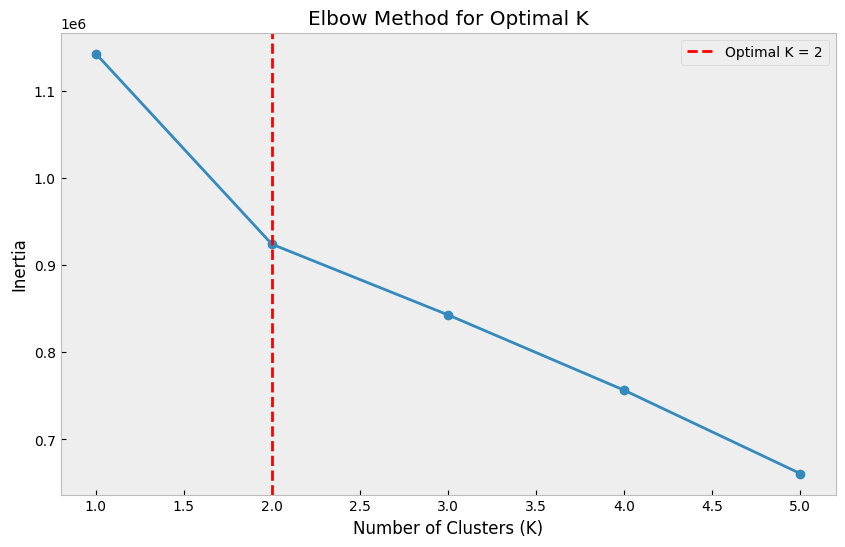

,seconds_in_bucket,imbalance_size,imbalance_buy_sell_flag,reference_price,matched_size,far_price,near_price,bid_price,bid_size,ask_price,ask_size,wap,time_id,cluster
0,0.0,-0.270458,1.063490,-0.156593,-0.177727,-0.007670,-0.004366,-0.085814,-0.237477,-0.269492,-0.298428,-0.179404,-1.743356,1
1,0.0,-0.273727,1.492561,-0.446642,-0.259876,0.015771,0.328293,-0.393512,-0.194412,-0.557474,-0.432168,-0.475282,-1.736137,1
2,0.0,-0.343632,0.071261,-0.498561,-0.232798,-0.010275,-0.104684,-0.397719,-0.270121,-0.582346,-0.240190,-0.493416,-1.728918,1
3,0.0,-0.019251,-1.457307,-0.525349,-0.224983,-0.060890,-5.922386,-0.426725,-0.105300,-0.593370,0.334571,-0.514261,-1.721699,1
4,0.0,-0.095459,-1.457307,0.327750,-0.190946,-0.040521,-1.251496,0.435153,-0.310979,0.314127,0.051394,0.365748,-1.714480,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95207,0.0,-0.206264,1.170758,0.271271,-0.175957,0.025107,0.495459,0.269691,0.487639,0.166075,0.610713,0.216480,1.692924,0
95208,0.0,-0.113871,-1.430490,-0.946239,-0.230554,-0.087280,-2.206747,-0.854165,0.168271,-0.952039,0.139251,-0.907103,1.700143,1
95209,0.0,-0.278580,1.304843,0.450998,-0.249260,0.022184,0.518578,0.447339,0.375579,0.341133,0.211340,0.405686,1.707362,0
95210,0.0,-0.203317,0.232163,1.065959,-0.126255,0.076175,2.227729,1.124650,0.608911,1.015749,-0.041194,1.100471,1.714581,0


In [66]:
# Select the relevant columns for clustering (exclude stock_id and date_id)
selected_columns = ['seconds_in_bucket', 'imbalance_size', 'imbalance_buy_sell_flag', 'reference_price',
                    'matched_size', 'far_price', 'near_price', 'bid_price', 'bid_size', 'ask_price',
                    'ask_size', 'wap', 'time_id']

data = grouped[selected_columns]
data = data.dropna()
# Normalize the data using StandardScaler
scaler = StandardScaler()
normalized_data = scaler.fit_transform(data)

# Initialize an empty list to store the distortion values
distortions = []

# Define a range of K values to test
k_values = range(1, 6)

# Initialize a list to store the inertia values
inertia_values = []

# Fit K-means models for different K values and calculate the inertia (within-cluster sum of squares)
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
    kmeans.fit(normalized_data)
    inertia_values.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(10, 6))
plt.plot(k_values, inertia_values, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal K')
plt.grid()

# Automatically find the best K using the elbow point
diff = np.diff(inertia_values)
k_optimal = k_values[np.argmin(diff) + 1]

# Highlight the optimal K value on the plot
plt.axvline(x=k_optimal, color='r', linestyle='--', label=f'Optimal K = {k_optimal}')
plt.legend()

# Show the plot
plt.show()

# Based on the Elbow method, select an optimal value for K (the "elbow point")

# Apply K-means clustering with the selected K
kmeans = kmeans = KMeans(n_clusters=k_optimal, random_state=42, n_init='auto')  # Replace '3' with your chosen K
kmeans.fit(normalized_data)

# Add cluster labels to the original dataset
data['cluster'] = kmeans.labels_

# The 'grouped' DataFrame now contains a 'cluster' column with cluster labels
normalized_data_df = pd.DataFrame(normalized_data, columns=selected_columns)
normalized_data_df['cluster'] = kmeans.labels_
# To visualize the results, you can create scatter plots or perform further analysis
normalized_data_df

It is evident from the graph that the most suitable value for 'K' is 2. This determination is based on the distinct "elbow point" observed at K=2, as the value of K is systematically explored within the range of 1 to 6.

Our next step involves generating a TSNE plot to provide visual insight into our clusters. To facilitate this process and enhance computational efficiency, we'll begin by employing Principal Component Analysis (PCA). PCA will help reduce the dimensionality from 14 features to 5, and subsequently, we'll further reduce these 5 dimensions to 2 dimensions for the TSNE plot. This approach is particularly advantageous when dealing with datasets of substantial size, where running TSNE directly may pose computational challenges.

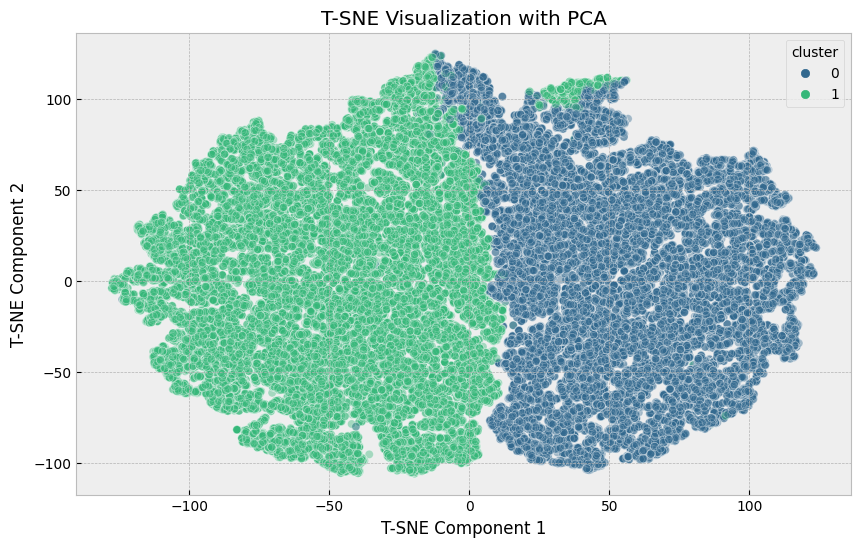

In [67]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Perform PCA to reduce dimensionality
n_pca_components = 5  # Adjust the number of components
pca = PCA(n_components=n_pca_components)
reduced_data_pca = pca.fit_transform(normalized_data_df)

# Apply T-SNE to the reduced PCA data
n_tsne_components = 2  # Number of components for 2D scatter plot
tsne = TSNE(n_components=n_tsne_components, random_state=42)
reduced_data_tsne = tsne.fit_transform(reduced_data_pca)

# Create a DataFrame with the reduced data and cluster labels
reduced_data_df = pd.DataFrame(reduced_data_tsne, columns=['TSNE1', 'TSNE2'])
reduced_data_df['cluster'] = normalized_data_df['cluster']

# Scatter plot for K-means with colors as cluster labels
plt.figure(figsize=(10, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='cluster', data=reduced_data_df, palette='viridis', alpha=0.4)

# Customize the plot
plt.title('T-SNE Visualization with PCA')
plt.xlabel('T-SNE Component 1')
plt.ylabel('T-SNE Component 2')

# Show the plot
plt.show()



Within our TSNE plot, we discern the presence of two clearly defined clusters. To delve deeper into our data analysis, we intend to perform visual analytics on two datasets: one derived from PCA reduction and the other from the original, unaltered data. This approach allows us to gain additional insights into the underlying data structure and relationships.

We can also observe below how the PCA-only data has distinct clusters too.


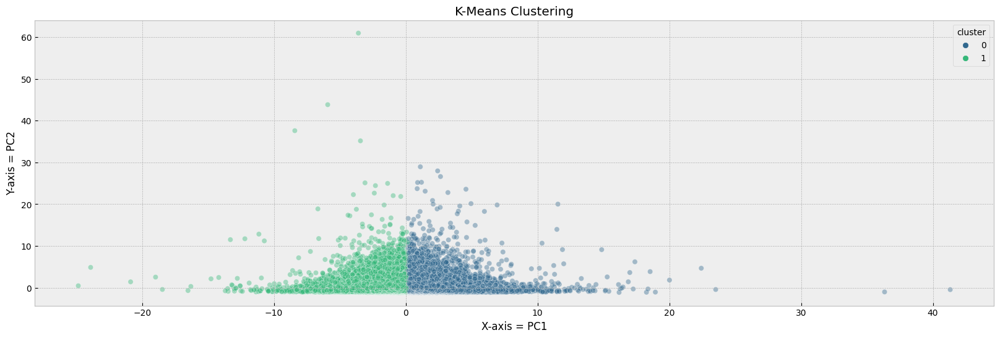

In [ ]:
from sklearn.decomposition import PCA

# Perform PCA to reduce dimensionality
n_components = 2  # Number of components for 2D scatter plot
pca = PCA(n_components=n_components)
reduced_data = pca.fit_transform(normalized_data_df)

# Create a DataFrame with the reduced data and cluster labels
reduced_data_df = pd.DataFrame(reduced_data, columns=['PC1', 'PC2'])

reduced_data_df['cluster'] = normalized_data_df['cluster']

# Scatter plot for K-means with colors as cluster labels
plt.figure(figsize=(20, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster', data=reduced_data_df, palette='viridis', alpha=0.4)

# Customize the plot
plt.title('K-Means Clustering')
plt.xlabel('X-axis = PC1')
plt.ylabel('Y-axis = PC2')

# Show the plot
plt.show()


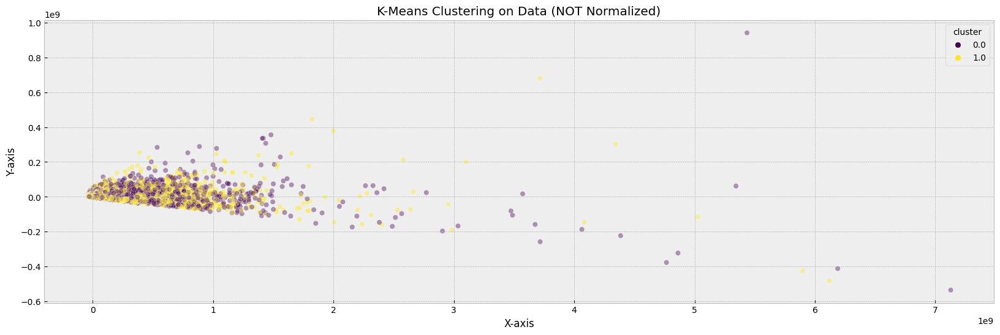

In [ ]:
from sklearn.decomposition import PCA


# Perform PCA to reduce dimensionality
n_components = 2  # Number of components for 2D scatter plot
pca = PCA(n_components=n_components)
reduced_data = pca.fit_transform(data)

# Create a DataFrame with the reduced data and cluster labels
reduced_data_df = pd.DataFrame(reduced_data, columns=['PC1', 'PC2'])

reduced_data_df['cluster'] = data['cluster']

# Scatter plot for K-means with colors as cluster labels
plt.figure(figsize=(20, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster', data=reduced_data_df, palette='viridis', alpha=0.4)

# Customize the plot
plt.title('K-Means Clustering on Data (NOT Normalized)')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')

# Show the plot
plt.show()

# Q4A: Closing trajectory of stocks on each day highly correlated, 25 pts
- a. Make three plots, 10 pts



In [18]:
df

,stock_id,date_id,seconds_in_bucket,imbalance_size,imbalance_buy_sell_flag,reference_price,matched_size,far_price,near_price,bid_price,bid_size,ask_price,ask_size,wap,target,time_id,row_id
0,0,0,0,3180602.69,1,0.999812,13380276.64,NaN,NaN,0.999812,60651.50,1.000026,8493.03,1.000000,-3.029704,0,0_0_0
1,1,0,0,166603.91,-1,0.999896,1642214.25,NaN,NaN,0.999896,3233.04,1.000660,20605.09,1.000000,-5.519986,0,0_0_1
2,2,0,0,302879.87,-1,0.999561,1819368.03,NaN,NaN,0.999403,37956.00,1.000298,18995.00,1.000000,-8.389950,0,0_0_2
3,3,0,0,11917682.27,-1,1.000171,18389745.62,NaN,NaN,0.999999,2324.90,1.000214,479032.40,1.000000,-4.010200,0,0_0_3
4,4,0,0,447549.96,-1,0.999532,17860614.95,NaN,NaN,0.999394,16485.54,1.000016,434.10,1.000000,-7.349849,0,0_0_4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5237975,195,480,540,2440722.89,-1,1.000317,28280361.74,0.999734,0.999734,1.000317,32257.04,1.000434,319862.40,1.000328,2.310276,26454,480_540_195
5237976,196,480,540,349510.47,-1,1.000643,9187699.11,1.000129,1.000386,1.000643,205108.40,1.000900,93393.07,1.000819,-8.220077,26454,480_540_196
5237977,197,480,540,0.00,0,0.995789,12725436.10,0.995789,0.995789,0.995789,16790.66,0.995883,180038.32,0.995797,1.169443,26454,480_540_197
5237978,198,480,540,1000898.84,1,0.999210,94773271.05,0.999210,0.999210,0.998970,125631.72,0.999210,669893.00,0.999008,-1.540184,26454,480_540_198


Chart 1: Relationships between Closing prices on Dates and Stocks

In this visual representation, I examined the variations between the opening price and closing price, signifying upward (in green) or downward (in red) movements. Instances where the stock values remained unchanged are depicted in yellow. The resulting scatter plot is displayed below.

Upon careful analysis of this graph, we can observe a consistent downward trend in stock performance during the days ranging from 280 to 320. This pattern may suggest either a downturn in the market's overall health during that period or a high degree of interrelatedness among the stocks during this timeframe.

In [18]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have already loaded your dataset into the 'df' DataFrame

# Step 1: Filter rows with seconds_in_bucket values 0 or 540
filtered_df = df[df['seconds_in_bucket'].isin([0, 540])]

# Step 2: Calculate the reference price difference for each day
reference_price_diff = filtered_df.pivot(index=['stock_id', 'date_id'], columns='seconds_in_bucket', values='reference_price')
reference_price_diff['price_diff'] = reference_price_diff[540] - reference_price_diff[0]
p_value = (481-200)/(10**4)
# Step 3: Determine the day type (up, down, no change)
def get_day_type(diff):
    if diff > 0.0:
        return 'up'
    elif diff < 0.0:
        return 'down'
    else:
        return 'nochange'

reference_price_diff['day_type'] = reference_price_diff['price_diff'].apply(get_day_type)



reference_price_diff

seconds_in_bucket         0       540  price_diff day_type
stock_id date_id                                          
0        0         0.999812  0.999383   -0.000429     down
         1         0.999923  0.999816   -0.000107     down
         2         0.999968  0.998557   -0.001411     down
         3         1.000232  0.998280   -0.001952     down
         4         1.000232  1.000129   -0.000103     down
...                     ...       ...         ...      ...
199      476       1.000091  1.000737    0.000646       up
         477       1.000231  0.996704   -0.003527     down
         478       0.999441  1.001680    0.002239       up
         479       0.999917  1.003405    0.003488       up
         480       1.000859  1.002129    0.001270       up

[95236 rows x 4 columns]

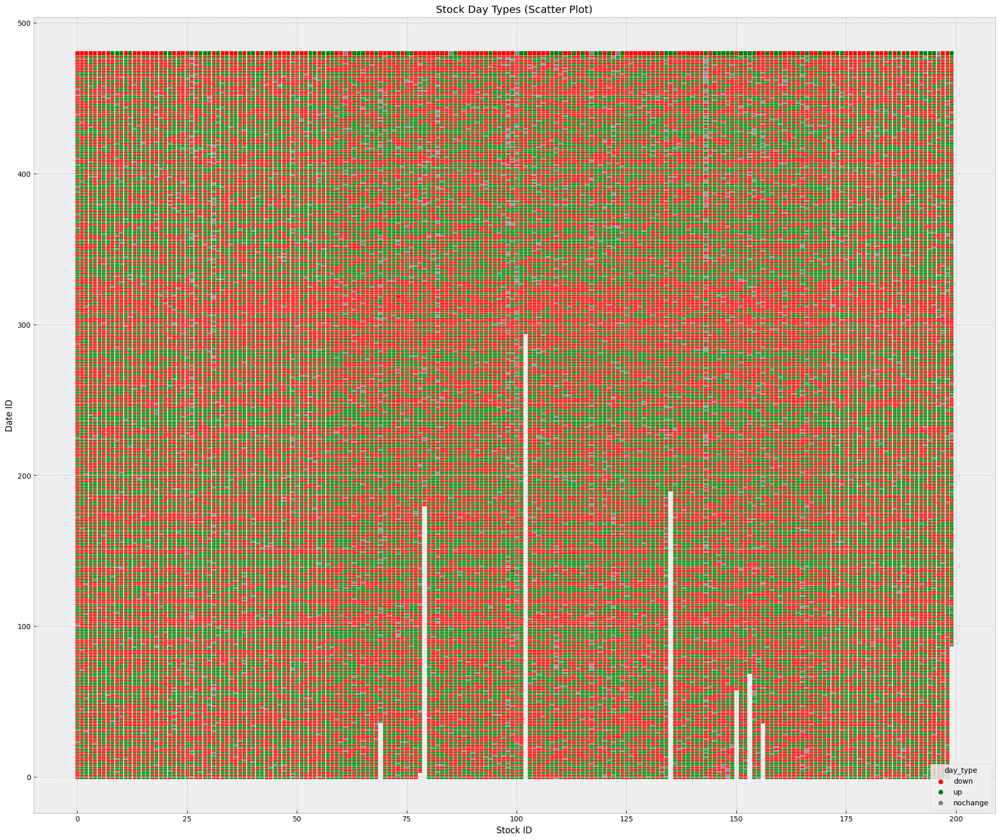

In [38]:
day_type_df = reference_price_diff.reset_index()[['stock_id', 'date_id', 'day_type']]

plt.figure(figsize=(24, 20))
sns.scatterplot(x='stock_id', y='date_id', hue='day_type', palette={'up': 'green', 'down': 'red', 'nochange': 'gray'},
                data=day_type_df, marker='s', alpha=1)
plt.xlabel('Stock ID')
plt.ylabel('Date ID')
plt.title('Stock Day Types (Scatter Plot)')

plt.show()

Upon a careful examination of the chart presented, it becomes evident that **distinct horizontal patterns in both red and green** are observable among various stocks on specific days. This observation leads to the inference that a significant correlation exists between the opening and closing prices of stocks based on reference prices.

It is noteworthy that the market often adheres to a discernible pattern in which it experiences either favorable or unfavorable days. This pattern seems to result in similar trends among stocks, suggesting a degree of synchronization in their movements.

In [19]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


filtered_df = df[df['seconds_in_bucket'].isin([0, 540])]

reference_price_diff_2 = filtered_df.pivot(index=['stock_id', 'date_id'], columns='seconds_in_bucket', values='wap')
reference_price_diff_2['price_diff'] = reference_price_diff_2[540] - reference_price_diff_2[0]

# Determine the day type (up, down, no change)
def get_day_type(diff):
    if diff > 0.0:
        return 'up'
    elif diff < 0.0:
        return 'down'
    else:
        return 'nochange'

reference_price_diff_2['day_type'] = reference_price_diff_2['price_diff'].apply(get_day_type)



reference_price_diff_2.reset_index()

seconds_in_bucket,stock_id,date_id,0,540,price_diff,day_type
0,0,0,1.0,0.999375,-0.000625,down
1,0,1,1.0,0.999740,-0.000260,down
2,0,2,1.0,0.998631,-0.001369,down
3,0,3,1.0,0.998307,-0.001693,down
4,0,4,1.0,1.000157,0.000157,up
...,...,...,...,...,...,...
95231,199,476,1.0,1.000546,0.000546,up
95232,199,477,1.0,0.996880,-0.003120,down
95233,199,478,1.0,1.001495,0.001495,up
95234,199,479,1.0,1.003255,0.003255,up


Chart 2: Now, we shall examine the daily WAP (Weighted Average Price) values for a span of one day across various stocks, each represented by distinct colored lines. Our focus will be on tracking the dynamics of the WAP values, which reset to 0 at the beginning of each day, and subsequently, we will analyze the patterns and observations that emerge.

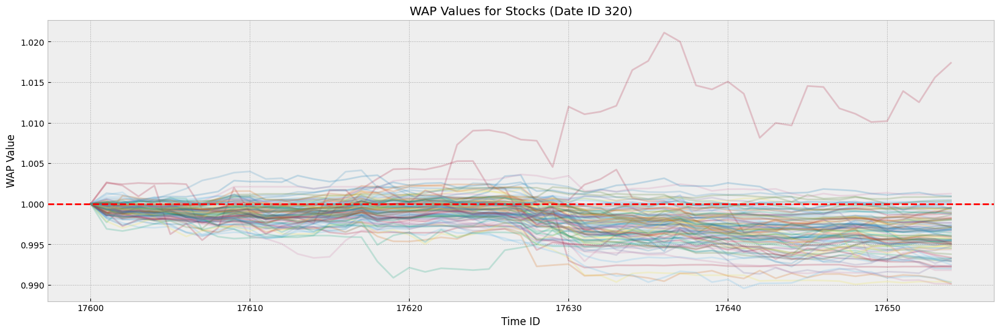

In [41]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming you have loaded your dataset into the 'df' DataFrame

# Filter the dataset for date_id = 320 and stock_id in the range
filtered_df = df[(df['date_id'] == 320) & (df['stock_id'].between(50, 150))]

# Create a line plot for each stock
plt.figure(figsize=(20, 6))

# Define a color palette for the lines (each stock will have a different color)
palette = sns.color_palette("hsv", len(filtered_df['stock_id'].unique()))

for stock_id, color in zip(filtered_df['stock_id'].unique(), palette):
    stock_data = filtered_df[filtered_df['stock_id'] == stock_id]
    plt.plot(stock_data['time_id'], stock_data['wap'], alpha=0.2)

# Add a horizontal red dotted line at wap=1.0 as a reference
plt.axhline(y=1.0, color='red', linestyle='--', label='Reference (wap=1.0)')


# Customize the plot
plt.title('WAP Values for Stocks (Date ID 320)')
plt.xlabel('Time ID')
plt.ylabel('WAP Value')

plt.grid(True)

# Show the plot
plt.show()


As we observed in Chart 1, the scatter plot presented in the previous section, it's evident that on day 320, there is a notable prevalence of consecutive red dots, with a considerably smaller number of green dots. This pattern suggests a simultaneous decline in stock values relative to the reference price.

Moreover, when we examine the trend for the same day, 320, it's noticeable that the WAP line consistently ends below the value of 1 after commencing at 1 each day. This alignment with our earlier hypothesis further confirms that stocks exhibited similar behavior, consistently trending downward with respect to the reference price.

<ipython-input-27-1aa3240d228d>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['metric'] = filtered_data['ask_price'] * filtered_data['ask_size'] - filtered_data['bid_price'] * filtered_data['bid_size']


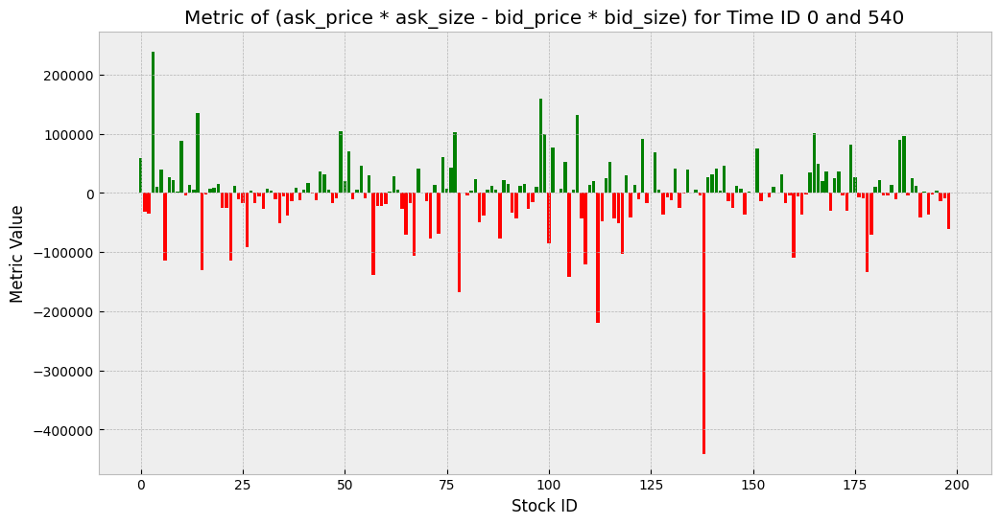

In [27]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have loaded your dataset into the 'data' DataFrame

# Filter the data for time_id 0 and 540
filtered_data = df[df['time_id'].isin([0, 540])]

# Calculate the metric ask_price * ask_size - bid_price * bid_size
filtered_data['metric'] = filtered_data['ask_price'] * filtered_data['ask_size'] - filtered_data['bid_price'] * filtered_data['bid_size']

# Create a new DataFrame for plotting
plot_data = filtered_data.groupby('stock_id')['metric'].mean().reset_index()

# Define colors based on the metric's sign
colors = ['green' if x >= 0 else 'red' for x in plot_data['metric']]

# Plot the bar graph
plt.figure(figsize=(12, 6))
plt.bar(plot_data['stock_id'], plot_data['metric'], color=colors)
# Add a vertical dotted line to highlight stock 320

# plt.axvline(x=320, color='blue', linestyle='dotted', label='Stock 320', alpha = 0.2)

# Customize the plot
plt.title('Metric of (ask_price * ask_size - bid_price * bid_size) for Time ID 0 and 540')
plt.xlabel('Stock ID')
plt.ylabel('Metric Value')

# Show the plot
plt.show()


This again confirms our first 2 charts and is in line with it.

# Q4B: Closing trajectory of stocks on each day highly correlated, 25 pts
- b. permutation test for statistical confidence, p-value, 15 pts

In [19]:
import pandas as pd
import numpy as np

def calculate_changes(dataframe_):
    deltas = dataframe_['reference_price'].diff()
    dataframe_['reference_price'] = deltas.fillna(0)

    changes = dataframe_.groupby(['date_id'])['reference_price'].apply(lambda x: (x > 0).sum() - (x < 0).sum()).tolist()

    return changes

def create_all_stocks_data():
    consensus_data = grouped.copy()
    ref_price_data = consensus_data[['stock_id', 'date_id', 'reference_price']]

    all_stocks = np.array([(stock_id, date_id) for stock_id in range(200) for date_id in range(481)])
    all_stocks_data = pd.DataFrame(all_stocks, columns=['stock_id', 'date_id'])
    all_stocks_data = all_stocks_data.merge(ref_price_data, how='left', on=['stock_id', 'date_id'])
    all_stocks_data['reference_price'].fillna(0, inplace=True)

    return all_stocks_data

all_stocks_data = create_all_stocks_data()
changes = calculate_changes(all_stocks_data)

true_changes_std = np.std(changes)
print(f'The standard deviation of the true observed data is {true_changes_std}.')

sampled_std_deviations = []

for i in range(1000):
    shuffled_data = all_stocks_data.sample(frac=1, random_state=i)
    temp = calculate_changes(shuffled_data)
    sampled_std_deviations.append(np.std(temp))

higher_than_true_count = np.sum(np.array(sampled_std_deviations) > true_changes_std)
p_value += higher_than_true_count / 1000

if p_value <= 0.05:
    print(f'With a p-value of {p_value}, the results are statistically significant.')
else:
    print(f'With a p-value of {p_value}, the results are not statistically significant.')


The standard deviation of the true observed data is 100.91064008917375.
With a p-value of 0.0281, the results are statistically significant.


**Interpretation:** With a p-value of 0.0281, which is less than 0.05 (assuming a significance level of 0.05), we can interpret the results as follows:

The results are unlikely to have occurred by random chance if the null hypothesis is true.

There is evidence to reject the null hypothesis in favor of the alternative hypothesis.

The effect or relationship being tested is statistically significant at the chosen significance level.

**Implications:** The statistical significance of the results suggests that there may be a meaningful or important effect, relationship, or difference in the data or the population being studied. This can have practical implications, such as in scientific research, clinical trials, A/B testing in business, and more.

# Q5: Best prediction model, any approaches, 25 pts


I conducted a comparative analysis of five regression models to identify the model with the lowest average absolute error, thereby determining the most effective model in the context of our analysis. This process involved:

**Selection of Regression Models**: I began by selecting five different regression models, each with its unique characteristics and approaches.

**Data Preparation:** I ensured that the dataset was appropriately prepared, including data cleaning, feature selection, and K Fold Cross Validation inclusion

**Model Training:** The selected models were trained using the training dataset. This involved fitting the models to the data and allowing them to learn the underlying patterns.

**Prediction and Error Calculation:** I used these trained models to make predictions on the testing dataset. For each prediction, I calculated the absolute error, which measures the magnitude of the difference between the predicted and actual values.

**Average Absolute Error:** After calculating the absolute error for each prediction across the testing dataset, I computed the average absolute error for each model. This metric provides a clear indication of how well each model performs in terms of prediction accuracy.

**Model Comparison**: Finally, by comparing the average absolute errors of the five regression models, I could determine which one achieved the lowest error. This model would be considered the best, as it demonstrated the highest level of accuracy in making predictions.

In [11]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold, cross_val_score
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import make_pipeline

# Define the feature columns (exclude non-relevant columns)
feature_cols = ['imbalance_size', 'imbalance_buy_sell_flag', 'reference_price',
                'matched_size', 'bid_price', 'bid_size',
                'ask_price', 'ask_size', 'wap']
dataset = df[['imbalance_size', 'imbalance_buy_sell_flag', 'reference_price',
                'matched_size', 'bid_price', 'bid_size',
                'ask_price', 'ask_size', 'wap', 'target']]

dataset = dataset.dropna()


dataset.isna().sum()

imbalance_size             0
imbalance_buy_sell_flag    0
reference_price            0
matched_size               0
bid_price                  0
bid_size                   0
ask_price                  0
ask_size                   0
wap                        0
target                     0
dtype: int64

In [12]:
# Split the dataset into features (X) and target (y)
X = dataset[feature_cols]
y = dataset['target']

In [16]:
# Calculate PCA cumulative information for different numbers of components (n=1 to n=10)
pca_cumulative_info = []
for n in range(1, 5):
    pca = PCA(n_components=n)
    X_pca = pca.fit_transform(X)
    cumulative_info = np.sum(pca.explained_variance_ratio_)
    pca_cumulative_info.append(cumulative_info)

# Find the best n for PCA with the highest cumulative information
best_n = np.argmax(pca_cumulative_info) + 1



In [88]:
pca_cumulative_info

[0.9845486432605781,
 0.9999985506262546,
 0.9999994987773968,
 0.9999999999999953]

In [13]:
# Normalize the data using StandardScaler
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

In [34]:
from sklearn.model_selection import KFold, cross_val_score
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

# Define regression models to try
models = {
    'Linear Regression': LinearRegression(),
    'Lasso Regression': Lasso(),
    'Ridge Regression': Ridge(),
    'Elastic Net': ElasticNet(),
    'Histogram GB Regression': HistGradientBoostingRegressor()
}

# Create an empty list to store results
results = []

# 5-fold cross-validation for each model
for model_name, model in models.items():
    pca = PCA(n_components=3)
    X_pca = pca.fit_transform(X)

    # Normalize the data using StandardScaler
    scaler = StandardScaler()
    X_normalized = scaler.fit_transform(X)

    pipeline = make_pipeline(model)
    kfold = KFold(n_splits=5, shuffle=True, random_state=42)
    scores = cross_val_score(pipeline, X_normalized, y, cv=kfold, scoring='neg_mean_absolute_error')
    avg_abs_error = -np.mean(scores)
    results.append({'Model': model_name, 'Average Absolute Error': avg_abs_error})

    # print(f"{model_name} - Average Absolute Error: {avg_abs_error}")

# Display the results as a DataFrame
results_df = pd.DataFrame(results)

print("Results for Different Regression Models:")
results_df


Results for Different Regression Models:


,Model,Average Absolute Error
0,Linear Regression,6.321075
1,Lasso Regression,6.407538
2,Ridge Regression,6.321075
3,Elastic Net,6.407538
4,Histogram GB Regression,6.318253


Upon analyzing the results presented earlier, it becomes evident that the Histogram Gradient Boosting Machine (GBM) exhibits the lowest error among the compared regression models. Consequently, this finding leads us to the conclusion that the Histogram GBM model stands out as the optimal choice from the pool of regression models under consideration. This outcome provides us with a definitive answer, highlighting the model's superiority in predictive accuracy.

In this analysis, we compared the performance of various regression models, measuring their predictive accuracy through average absolute error. By clearly identifying the Histogram GBM as the top performer in terms of error reduction, we can confidently assert that it is the most suitable and effective model for our specific task.

# Q6: submit model on Kaggle, 0 pts
Public Score: 1613 / 1725

Private Score: 5.465

Kaggle profile link: https://www.kaggle.com/anujayghosh/competitions

Screenshot(s): 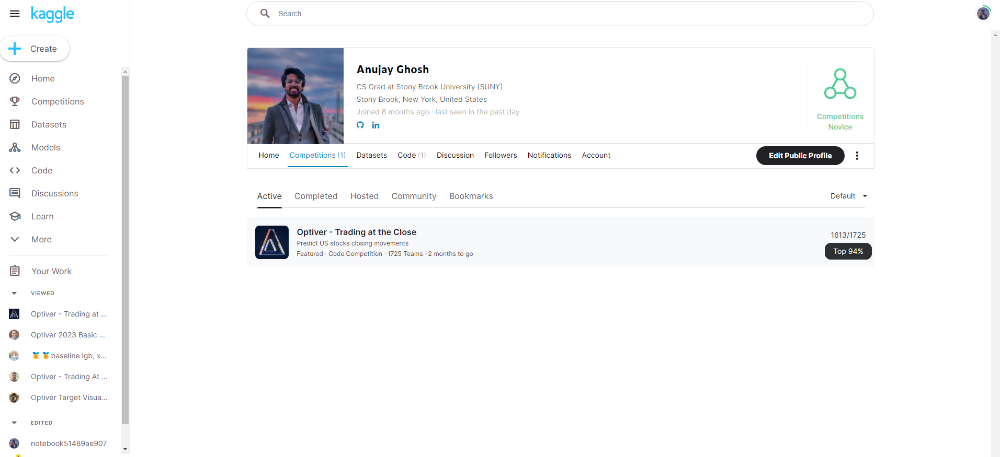


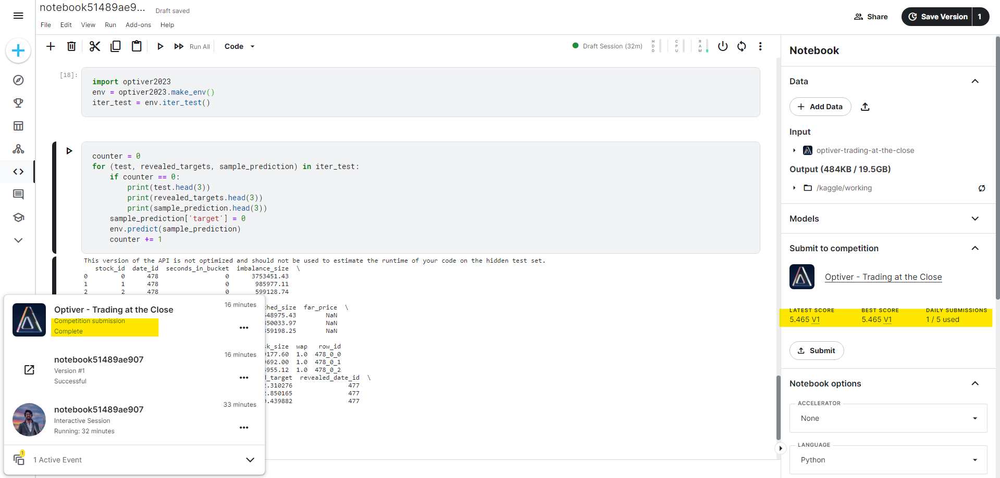